In [1]:
%load_ext autoreload
%autoreload 2
import sys
import os
sys.path.insert(0, 'models')
sys.path.insert(0, 'utils')
import celeba
import numpy as np
import wandb
import wandb
import matplotlib.pyplot as plt
import numpy as np
import torch
import argparse
from plotting_utils import plot_pytorch_images

model_size = 'large'
if model_size == 'large':
    from vae_model_large import VAE, loss_function
elif model_size == 'small':
    from vae_model_small import VAE, loss_function
from datasets import VAE_DATA

torch.manual_seed(0)
np.random.seed(0)

In [2]:
parser = argparse.ArgumentParser()
parser.add_argument("--num_datapoints", help="num datapoints", default=10000, type=int)
parser.add_argument("--resolution", help="num datapoints", default=64, type=int)
parser.add_argument("--z_dim", help="z dimension", default=85, type=int)
parser.add_argument("--device", help="gpu id", default=0, type=int)
parser.add_argument("--nb_epochs", help="number of epochs", default=500, type=int)
parser.add_argument("--start_epoch", help="epoch to start training from (requires checkpoints)", default=0, type=int)
parser.add_argument("--save_interval", help="epochs to save model", default=10, type=int)
parser.add_argument("--run_seed", help="run seed of TCVAE", default=100, type=int)
parser.add_argument("--lr", help="learning rate", default=.0001, type=float)
parser.add_argument("--batch_size", help="batch size", default=100, type=int)
parser.add_argument("--has_validation", help="If True, will use validation set", default=True, type=bool)
parser.add_argument("--validation_size", help="Validation set size", default=2000, type=int)
args = parser.parse_args([])

num_datapoints = args.num_datapoints
resolution = args.resolution

log = True
if log:
    wandb.init(project="vae", name="celeba_{}_{}_{}x{}".format(num_datapoints, model_size, resolution, resolution))
    wandb.config.update(args)

device = args.device
print("z_dim: {}".format(args.z_dim))
print("GPU: {}".format(device))
print("start_epoch: {}".format(args.start_epoch))
print("save_interval: {}".format(args.save_interval))

wandb: Wandb version 0.8.30 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


z_dim: 85
GPU: 0
start_epoch: 0
save_interval: 10


# Preparing Data

In [3]:
validation_size = 0
if args.has_validation:
    validation_size = args.validation_size
num_samples = num_datapoints + validation_size
dta = celeba.CelebA("../dsvae/yukun_disentanglement_lib/img_align_celeba", num_samples, resolution)
inputs = np.float32(dta.images[:num_datapoints])
torch_inputs = torch.from_numpy(inputs).permute(0,3,1,2)
torch_dataset = VAE_DATA(torch_inputs)
torch_data_loader = torch.utils.data.DataLoader(torch_dataset, batch_size=args.batch_size, shuffle=True)

if args.has_validation:
    val_inputs = np.float32(dta.images[num_datapoints:])
    torch_val_inputs = torch.from_numpy(val_inputs).permute(0,3,1,2)
    torch_val_dataset = VAE_DATA(torch_val_inputs)
    torch_val_data_loader = torch.utils.data.DataLoader(torch_val_dataset, batch_size=args.batch_size, shuffle=False)
del dta

12000
finish reading face images
(12000, 64, 64, 3)


# Instantiating and Training VAE

In [4]:
if device != -1 and device is not None:
    vae = VAE(z_dim=args.z_dim, input_shape=[3,resolution,resolution], device=device)
    vae.to(device)
else:
    vae = VAE(z_dim=args.z_dim, input_shape=[3,resolution,resolution], device=None)
optimizer = torch.optim.Adam(params=vae.parameters(), lr=args.lr)

Training for 500 epochs...


wandb: Wandb version 0.8.30 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


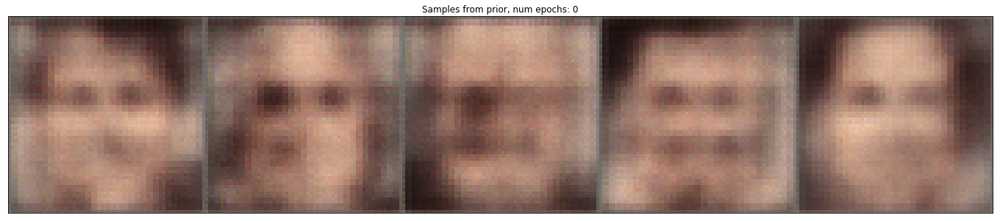

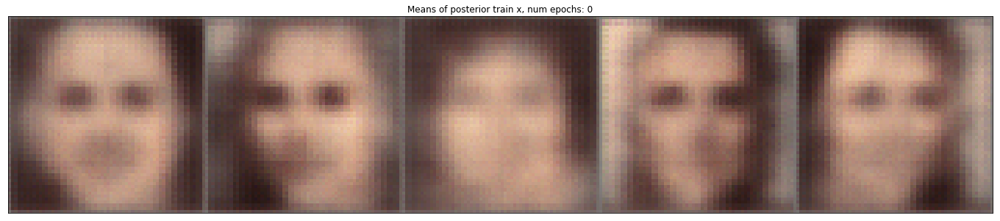

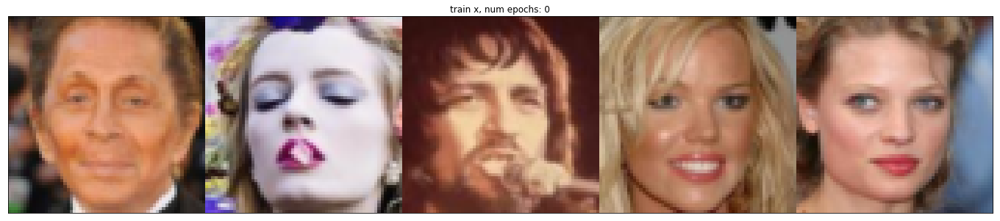

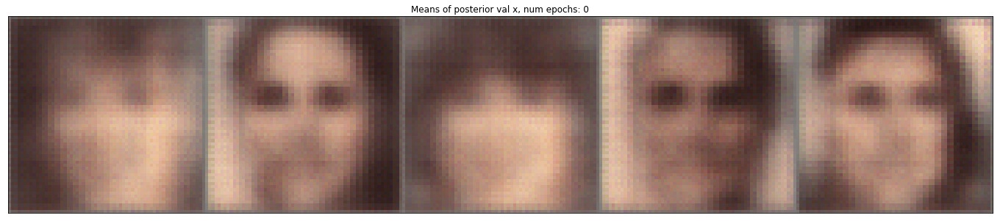

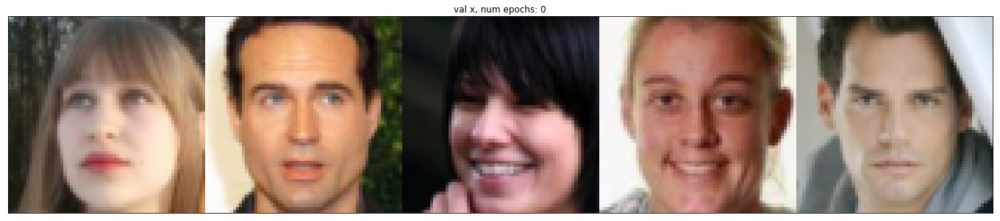

...

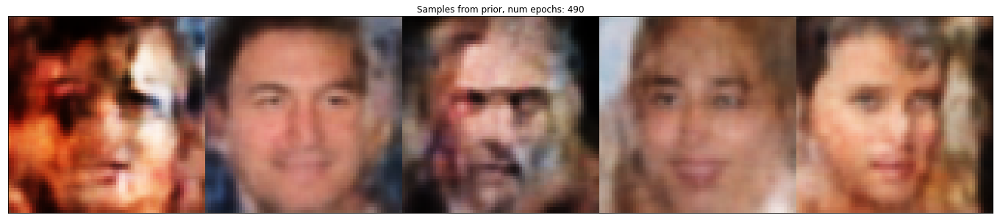

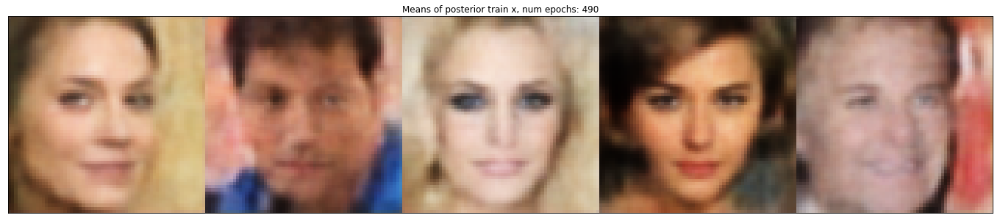

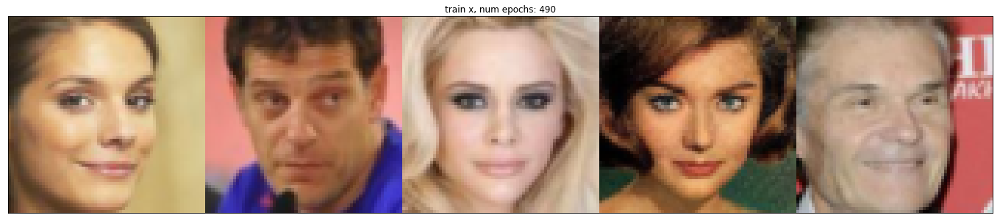

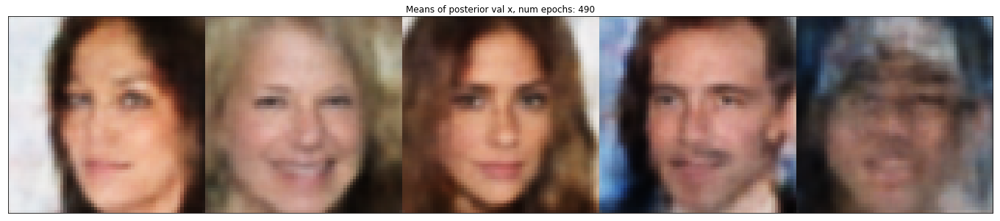

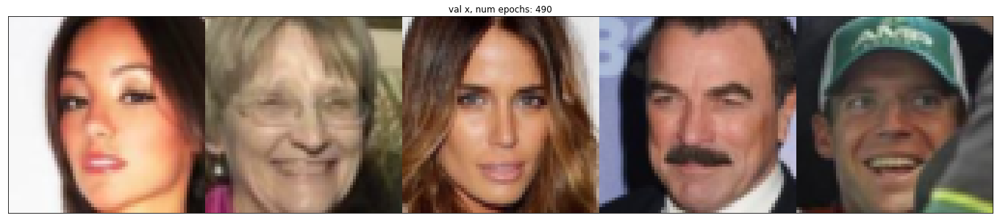

In [5]:
vae.train()
normal = torch.distributions.Normal(0,1)
print("Training for {} epochs...".format(500))
for n in range(0, 500):
    train_loss = 0
    train_recon_loss = 0
    train_kl_loss = 0
    num_examples = 0
    for (i, X) in enumerate(torch_data_loader):
        x = X
        if vae.cuda:
            x = x.to(device)
        optimizer.zero_grad()
        x_hat, z_mu, z_var = vae(x)
        loss, recon_loss, kl_loss = loss_function(x_hat, x, z_mu, z_var)
        train_loss += loss.item()
        train_recon_loss += recon_loss.item()
        train_kl_loss += kl_loss.item()
        num_examples += x_hat.shape[0]
        loss.backward()
        optimizer.step()
    if log:
        wandb.log({'train_loss':train_loss/num_examples})
        wandb.log({'train_recon_loss':train_recon_loss/num_examples})
        wandb.log({'train_kl_loss':train_kl_loss/num_examples})
        
    if args.has_validation:
        vae.eval()
        val_loss = 0
        val_recon_loss = 0
        val_kl_loss = 0
        num_examples = 0
        for (i, X) in enumerate(torch_val_data_loader):
            x_val = X
            if vae.cuda:
                x_val = x_val.to(device)
            x_hat_val, z_mu, z_var = vae(x_val)
            loss, recon_loss, kl_loss = loss_function(x_hat_val, x_val, z_mu, z_var)
            val_loss += loss.item()
            val_recon_loss += recon_loss.item()
            val_kl_loss += kl_loss.item()
            num_examples += x_hat_val.shape[0]
        if log:
            wandb.log({'val_loss':val_loss/num_examples})
            wandb.log({'val_recon_loss':val_recon_loss/num_examples})
            wandb.log({'val_kl_loss':val_kl_loss/num_examples})
        vae.train()
        
    if n%10 ==0:
        vae.eval() #evaluate model
        z_noise = normal.sample((x.shape[0],85))
        z_zeros = torch.zeros((x.shape[0],85))
        if vae.cuda:
            z_noise = z_noise.to(device)
            z_zeros = z_zeros.to(device)
        x_hat_noise = vae.decode(z_noise)
        x_hat_zeros = vae.decode(z_zeros)

        fig = plot_pytorch_images(x_hat_noise[:5], num_images=5, title='Samples from prior, num epochs: {}'.format(n))
        if log:
            wandb.log({'Samples from prior':fig})
            
        fig = plot_pytorch_images(x_hat[:5], num_images=5, title='Means of posterior train x, num epochs: {}'.format(n))
        if log:
            wandb.log({'Means of posterior train x':fig})
            
        fig = plot_pytorch_images(x[:5], num_images=5, title='train x, num epochs: {}'.format(n))
        if log:
            wandb.log({'train x':fig})
        
        if args.has_validation:
            x_val = torch_val_dataset[np.random.choice(range(len(torch_val_dataset)), size=5, replace=False)]
            if vae.cuda:
                x_val = x_val.to(device)
            x_val_hat, _, _ = vae(x_val)
            fig = plot_pytorch_images(x_val_hat[:5], num_images=5, title='Means of posterior val x, num epochs: {}'.format(n))
            if log:
                wandb.log({'Means of posterior val x':fig})

            fig = plot_pytorch_images(x_val[:5], num_images=5, title='val x, num epochs: {}'.format(n))
            if log:
                wandb.log({'val x':fig})

        vae.train() #back to training model

In [6]:
torch.save(vae, 'VAE_10K_64')